<h2>Mathematical and Computational Methods for Complex Systems</h2>

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import odeint
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px
import plotly.graph_objects as go
import pandas as pd
# I imported the Gillespie function provided for the assignment by Luc Berthouze
# and kept the file separate, to not clutter up my submission, as I didn't amend it in the final question
# As such, the file provided will need to be discoverable, i.e. in the same folder this notebook is run from
import gillespie_ABA as gaba
import scipy.interpolate as interpolate

# Maths and Comp Methods for Complex Systems Assessment
Candidate: 252679

# Analytical Work

## Q1

See the pdf of the handwritten work for Q1.

In [2]:
#Defining the system, here Y=(A,B)
def system(y, t, beta, gamma, n):
    dydt = [-beta*y[1]*y[0]/n+gamma*y[1], beta*y[1]*y[0]/n-gamma*y[1]]
    return dydt

## Q2

See the pdf of the handwritten work for analytically identifying the fixed points of the system and their stabilities for different values of R<sub>0</sub>. Here I plot the phase portraits for different values of beta and gamma, and as such R<sub>0</sub>, as R<sub>0</sub>=beta/gamma. I won't change N, as we can see that it will only affect the scale of the plots.

In [3]:
def streamplot_for_system(beta, gamma, n): 
    # Plot phase portrait with few sample trajectories for 
    # system with specified input parameters
    r0=beta/gamma
    bstar=n*(r0-1)/r0
    
    a,b = np.linspace(0,n,21),np.linspace(0,n,21)
    A,B = np.meshgrid(a,b) # Make a meshgrid from ranges of A and B
    if beta>gamma:
        #pick two points within plot but either side of non-zero fixed point, if exists, or...
        start = [[n-bstar/2,bstar/2],[bstar/2,n-bstar/2]]
    else:
        #if only one fixed point, just pick one start point
        start = [[n/2,n/2]]
    
    [U,V] = system([A,B],0,beta,gamma,n)
    fig0, ax0 = plt.subplots()
    strm = ax0.streamplot(A,B,U,V,color=(.75,.90,.93))
    strms = ax0.streamplot(A,B,U,V,start_points=start, color="crimson", linewidth=2)
    plt.title(f'Streamplot for beta={beta}, gamma={gamma}, n={n}')
    plt.xlabel('A')
    plt.ylabel('B')
    plt.show

#Quiver plot version
def quiverplot_for_system(beta, gamma, n):
    a,b = np.linspace(0,n,21),np.linspace(0,n,21)
    A,B = np.meshgrid(a,b)
    [U,V] = system([A,B],0,beta,gamma,n)
    plt.quiver(A,B,U,V)
    plt.title(f'Quiver Plot for beta={beta}, gamma={gamma}, n={n}')
    plt.xlabel('A')
    plt.ylabel('B')
    plt.show()

The stream and quiver plots below confirm that for R<sub>0</sub>>1, we have 2 fixed points and B* is stable, B=0 is unstable.

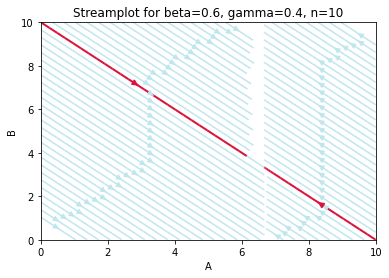

In [4]:
streamplot_for_system(0.6, 0.4, 10)

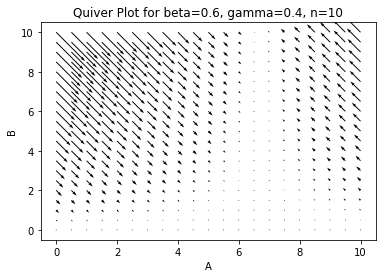

In [5]:
quiverplot_for_system(0.6, 0.4, 10)

The stream and quiver plots below confirm that for R<sub>0</sub><1, we have 1 stable fixed point, B=0.

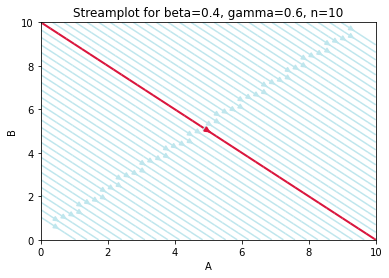

In [6]:
streamplot_for_system(0.4, 0.6, 10)

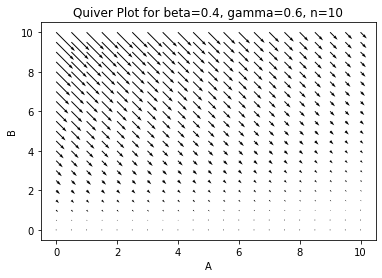

In [7]:
quiverplot_for_system(0.4, 0.6, 10)

The stream and quiver plots below confirm that for R<sub>0</sub>=1, we have 1 stable fixed point, B=0.

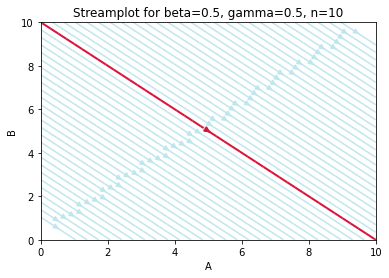

In [8]:
streamplot_for_system(0.5, 0.5, 10)

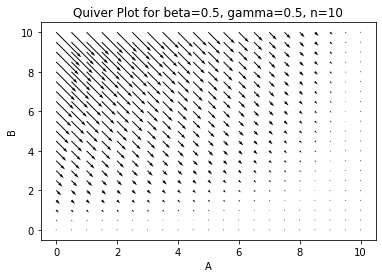

In [9]:
quiverplot_for_system(0.5, 0.5, 10)

Here I have plotted for another example where beta>gamma and R<sub>0</sub>>1, and we can see that the value for B* is closer to zero as the ratio of beta to gamma is smaller, and as such, R<sub>0</sub> is closer to 1.

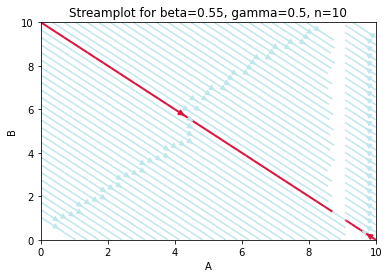

In [10]:
streamplot_for_system(0.55, 0.5, 10)

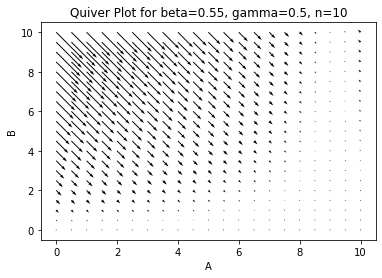

In [11]:
quiverplot_for_system(0.55, 0.5, 10)

## Q3

Here is my bifurcation plot for the system. I have chosen to use plotly, rather than matplotlib, as the 3D representation is clearer, and the user can manipulate the plot by left clicking and dragging, to rotate, which I think helps represent the bifurcation more clearly.

In [12]:
def bifurcationPlotSIS():
    # Parameters
    n=1000
    
    # R0
    r0 = np.linspace(0.1, 5, 1000)
    
    # Fixed points as functions of R0 and N, I could make these inputs and changeable,
    # but only need to plot once here
    a1 = [n]*1000
    b1 = [0]*1000
    a2np = n/r0
    b2np = n-n/r0
    a2=a2np.tolist()
    b2=b2np.tolist()
    pointId= ["(N,0)"]*1000+["(N-B*,B*)"]*1000
    a=a1+a2
    b=b1+b2
    r0Data=r0.tolist()+r0.tolist()
    data={"R0":r0Data,"A":a,"B":b,"Fixed Point":pointId}
    df=pd.DataFrame(data)
    
    fig = px.line_3d(df[df["B"]>=0], x="R0", y="A", z="B", color="Fixed Point")
    fig.show()


In [13]:
bifurcationPlotSIS()

## Q4

Please see the pdf showing the written work for my answer for Q4.

## Q5

Please see the same pdf for analytical verification of the convergence of my solution for B(t) derived in Q4. Here, I will plot solutions for B(t) for different values of B<sub>0</sub> and R<sub>0</sub>, then visually confirm the agreement between my solution and integrating via Euler's method. Again, I have chosen to use plotly as I prefer the user interface and presentation.

In [14]:
# Define solution [B](t)
def bSol(b0,t,beta, gamma, n):
    r0=beta/gamma
    bstar=n*(r0-1)/r0
    if r0==1:
        return 1/(beta*t/n+1/b0)
    else:
        return 1/(1/bstar+(1/b0-1/bstar)*np.exp((gamma-beta)*t))

#Plot B for a fixed t range for a chosen beta and gamma, here setting N=1000
def plotB(beta, gamma):
    r0=beta/gamma
    t=np.linspace(0, 200, 1)
    bs=[]
    b0s=[]
    ts=[]
    
    for b0 in range(1,1001,100):
        bs=bs+bSol(b0,t,beta,gamma,1000).tolist()
        b0s=b0s+[b0]*len(t)
        ts=ts+t.tolist()
    
    data={"t":ts,"B0":b0s,"B(t)":bs}
    df=pd.DataFrame(data)
    
    fig=px.line(df, x="t", y="B(t)", color="B0", title=f"R0={beta/gamma}, beta={beta}, gamma={gamma}, B*={max(1000*(r0-1)/r0,0)}")
    fig.show()

In [15]:
plotB(0.1,0.9)

In [16]:
plotB(0.5,0.9)

In [17]:
plotB(0.5,0.5)

In [18]:
plotB(0.1,0.1)

In [19]:
plotB(0.5,0.1)

In [20]:
plotB(0.5,0.3)

In [21]:
plotB(0.5,0.4)

In [22]:
plotB(0.55,0.5)

In [23]:
plotB(0.5,0.55)

In [24]:
plotB(0.6,0.3)

In [25]:
plotB(0.4,0.2)

In [26]:
plotB(0.2,0.4)

In [27]:
plotB(0.3,0.6)

We can see from the plots above that for large times t, each solution converges to B* when we have 2 fixed points, i.e. R<sub>0</sub>>1, and when R<sub>0</sub>$\le$1, it converges to B=0.

I shall now confirm my solution's agreement with Euler's method by plotting both and the differences below for when beta=gamma i.e. R<sub>0</sub>=1 as well as when it is greater or less than 1.

In [28]:
# Mean field equation, not integrated
def meanField(b,beta,gamma,n):
    return (beta-gamma)*b-beta*b**2/n

# Function to plot B solution, followed by Euler integration, followed by difference, on separate plots
def plotBVsEuler(b0,beta,gamma,n,tMax,tSteps):
    t=np.linspace(0, tMax, tSteps)
    bEuler=[b0]
    h=tMax/tSteps
    
    # Euler integration
    for i in np.arange(len(t)-1):
        bEuler=bEuler+[bEuler[i]+h*meanField(bEuler[i],beta,gamma,n)]
        
    b=bSol(b0,t,beta,gamma,n)
    data={"t":t,"Analytical Solution":b,"Euler Solution":bEuler,"Diff":b-bEuler}
    df=pd.DataFrame(data)
    
    fig=px.line(df,x="t", y="Analytical Solution", title=f"Analytical Solution: B0={b0}, beta={beta}, gamma={gamma}, N={n}, h={tMax/tSteps}")
    fig.show()
    fig=px.line(df,x="t", y="Euler Solution", title=f"Euler Solution: B0={b0}, beta={beta}, gamma={gamma}, N={n}, h={tMax/tSteps}")
    fig.show()
    fig=px.line(df,x="t", y="Diff", title=f"Difference: B0={b0}, beta={beta}, gamma={gamma}, N={n}, h={tMax/tSteps}")
    fig.show()

In [29]:
plotBVsEuler(100,0.5,0.5,1000,100,1000)
plotBVsEuler(100,0.75,0.5,1000,100,1000)
plotBVsEuler(100,0.5,0.75,1000,100,1000)

We can see that for different values for R<sub>0</sub>, decreasing h for Euler's method, decreases the differences proportionally, so as h decreases to 0, Euler's method will converge to my solution.

In [30]:
plotBVsEuler(100,0.5,0.5,1000,100,10000)
plotBVsEuler(100,0.75,0.5,1000,100,10000)
plotBVsEuler(100,0.5,0.75,1000,100,10000)

# Simulation Work

In [31]:
# Function to plot Gillespie iterations, with average and/or mean-field equation as specified
# Contains amendment to remove outliers, described in Q4
def plotGillespie(N,B0,beta,gamma,Tmax,iterations,plotAvg=False,plotMF=False,removeOutliers=False):
    r0=beta/gamma
    t=np.linspace(0, Tmax, 500)
    Ts=[]
    TLens=[0]
    Bs=[]
    B_interps=[]
    B_avg=np.zeros(len(t))
    
    #Gillespie Iterations
    for i in range(iterations):
        # I imported the Gillespie function provided for the assignment by Luc Berthouze
        # and kept the file separate, to not clutter up my submission
        (T,A,B)=gaba.gillespie_ABA(N,B0,beta,gamma,Tmax)
        Ts.append(T)
        Bs.append(B)
        if plotAvg:
            f=interpolate.interp1d(T, B)
            B_interp=f(t)
            B_interps.append(B_interp)
            B_avg=np.add(B_avg,B_interp/iterations)
    
    for i in range(iterations):
        plt.plot(Ts[i],Bs[i])
        
    #Average Calculation
    if plotAvg:
        B_stddevs=[]
        for k in range(len(t)):
            total=0
            for i in range(iterations):
                total+=np.power((B_interps[i][k]-B_avg[k]),2)
            B_stddevs.append(np.power(total/N,0.5))
        
        if removeOutliers:
            for k in range(1,len(t)):
                Bts=[]
                for i in range(iterations):
                    Bts.append(B_interps[i][k])
                iq_range=np.quantile(Bts,[0.25,0.75])
                for j in Bts:
                    if j>iq_range[1] or j<iq_range[0]:
                        Bts.remove(j)
                B_avg[k]=np.mean(Bts)
                
        plt.errorbar(t, B_avg, yerr=B_stddevs, fmt='none', ecolor='lightgray');
        plt.plot(t,B_avg,label='Gillespie Average',linewidth=4)
        
    #Integrated Mean Field Solution
    if plotMF:
        B_sol=bSol(B0,t,beta,gamma,N)
        plt.plot(t,B_sol,label='Mean-Field Solution',linewidth=4)
        
    plt.rcParams["figure.figsize"] = (20,10)
    plt.xlabel("t (s)")
    plt.ylabel("B(t)")
    plt.title(f"R0={r0}, beta={beta}, gamma={gamma}, B*={1000*(r0-1)/r0}, N={N}, B0={B0}")
    if plotAvg or plotMF:
        plt.legend()
    plt.show()

## Q1

I will now plot 100 realisations for different combinations of R<sub>0</sub>=5, R<sub>0</sub>=0.2, R<sub>0</sub>=1; N=1000, N=10; B<sub>0</sub>=0.9N, B<sub>0</sub>=0.1N.

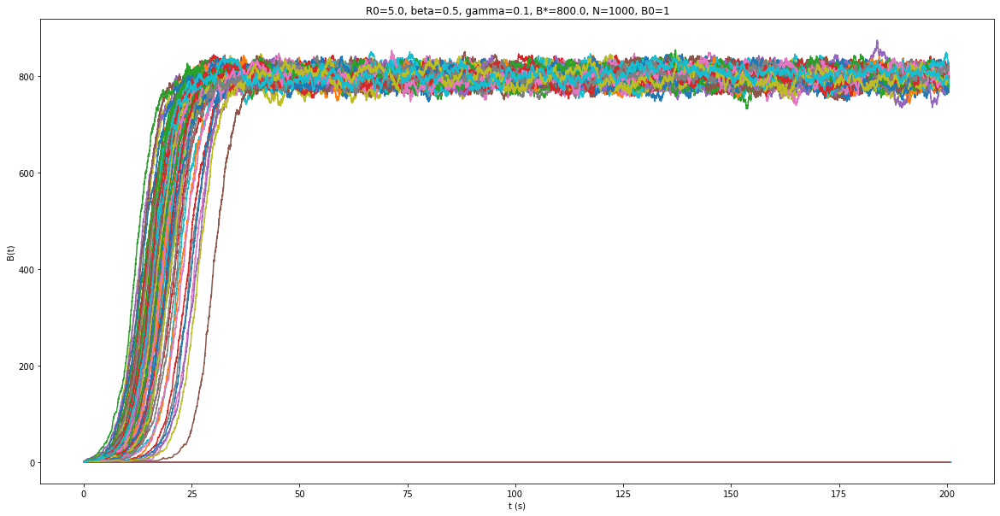

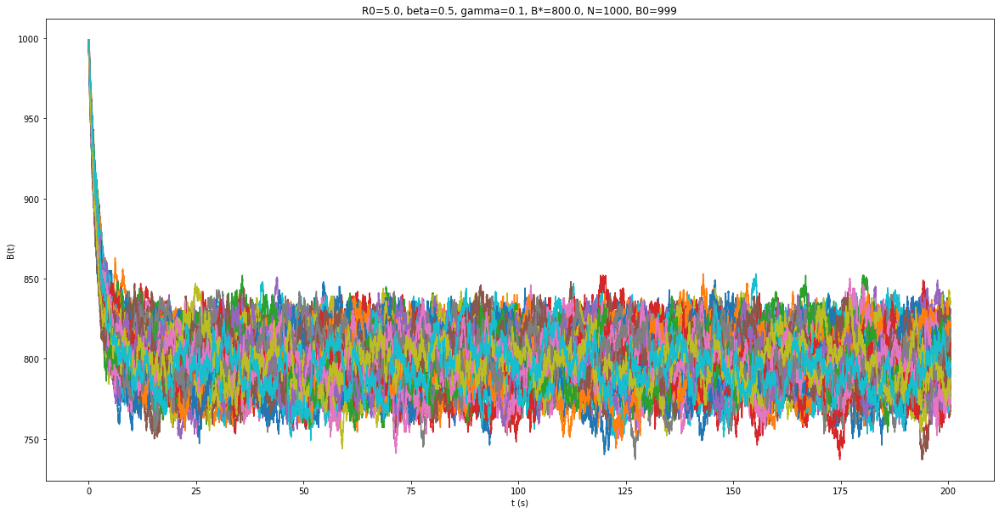

In [50]:
plotGillespie(1000,1,0.5,0.1,200,100)
plotGillespie(1000,999,0.5,0.1,200,100)

In the first plot above, when we start at B<sub>0</sub>=1, we have at least one iteration that converges to 0, whilst all of the others fluctuate around B<sup>*</sup>. In the second, starting at B<sub>0</sub>=999, we do not have such an occurence, therefore I would expect the average to be similar to the mean-field solution, whereas for the former, the average will be skewed towards the anomalous results. Note that here, R<sub>0</sub> is large, and we expect convergence to B*.

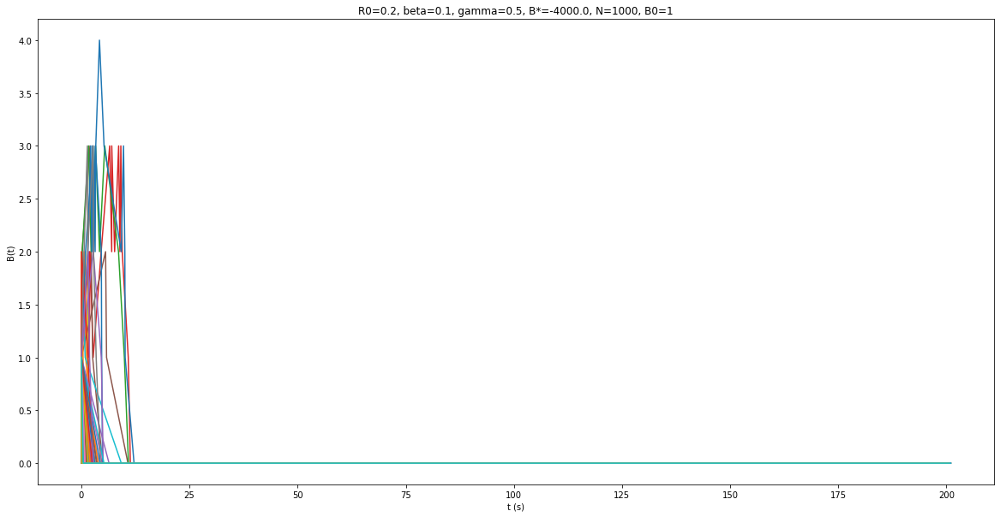

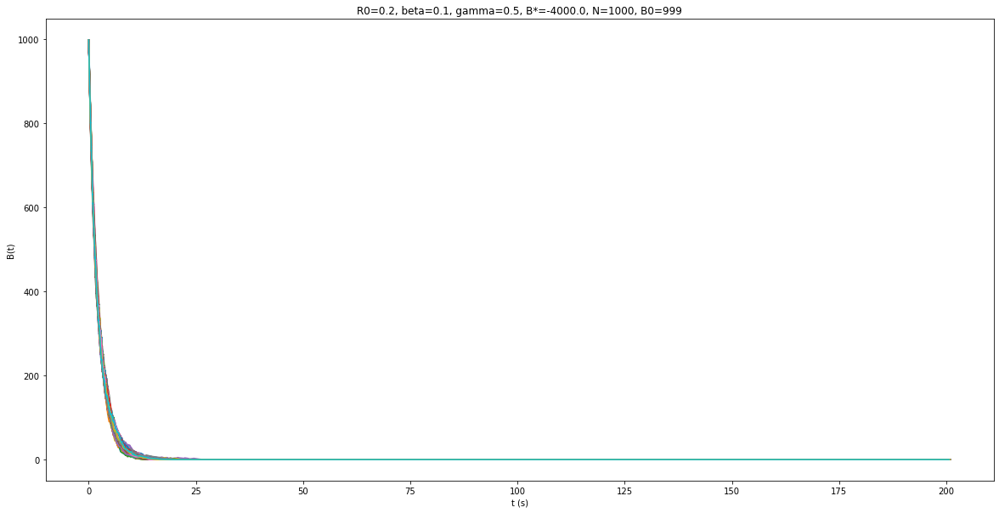

In [33]:
plotGillespie(1000,1,0.1,0.5,200,100)
plotGillespie(1000,999,0.1,0.5,200,100)

In the first plot above, when we start at B<sub>0</sub>=1, we have some fluctuations, but all iterations appear to converge quickly to 0. In the second, starting at B<sub>0</sub>=999, all iterations appear to converge at a similar rate. Note that here, R<sub>0</sub> is very small, and we expect convergence to 0.

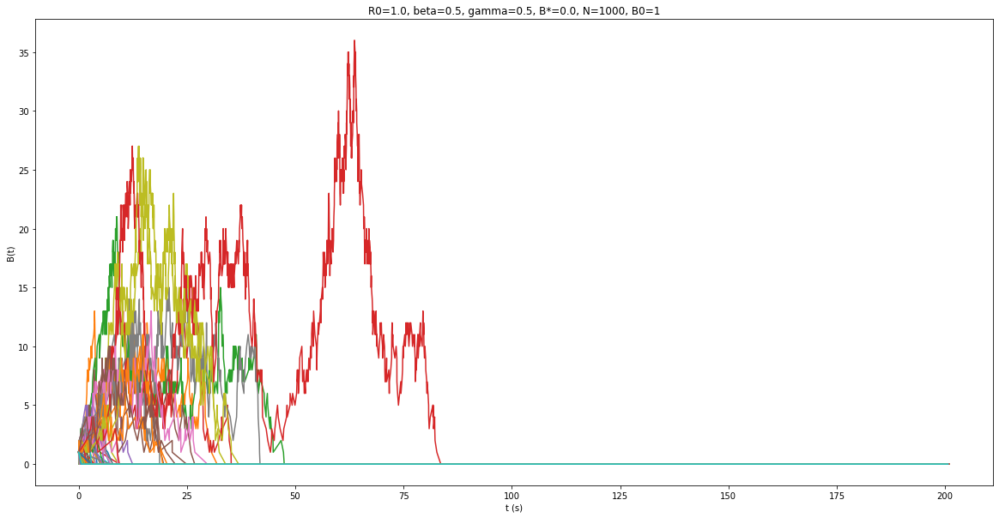

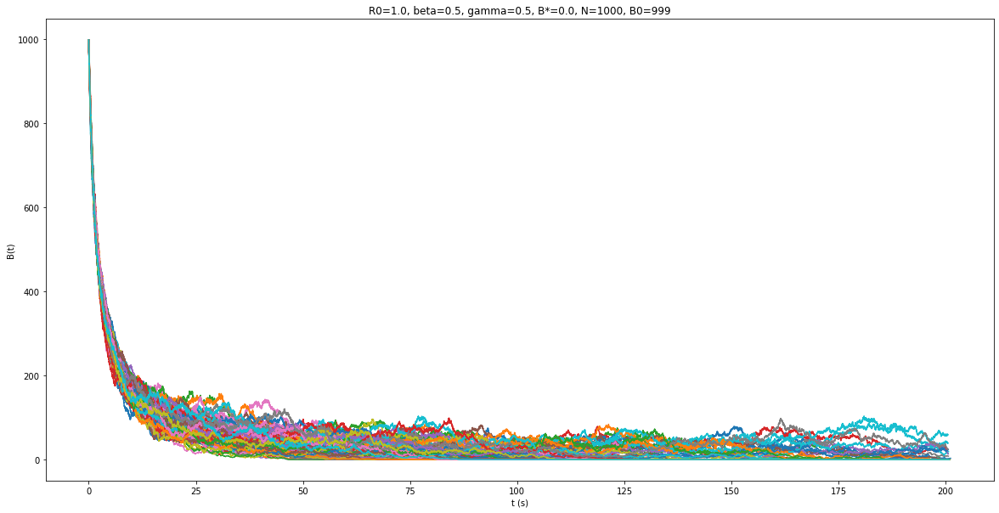

In [34]:
plotGillespie(1000,1,0.5,0.5,200,100)
plotGillespie(1000,999,0.5,0.5,200,100)

In the first plot above, when we start at B<sub>0</sub>=1, we have a more, larger fluctuations before convergence to 0 than in the first plot for the previous parameters. Note that here, R<sub>0</sub>=1, whereas above it was less than 1. In the second, starting at B<sub>0</sub>=999, it appears that convergence to 0 takes a lot longer for some iterations, some don't even converge with the TMax I have set at 200.

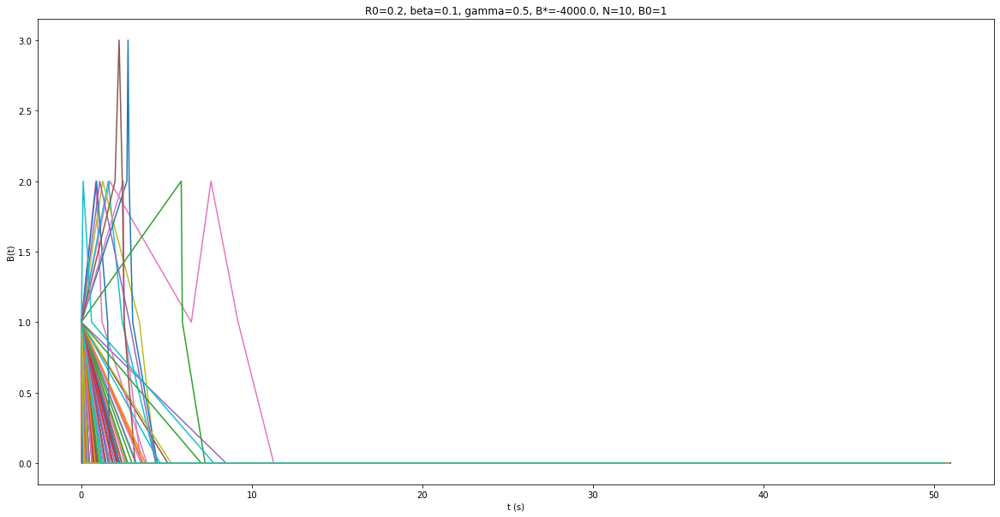

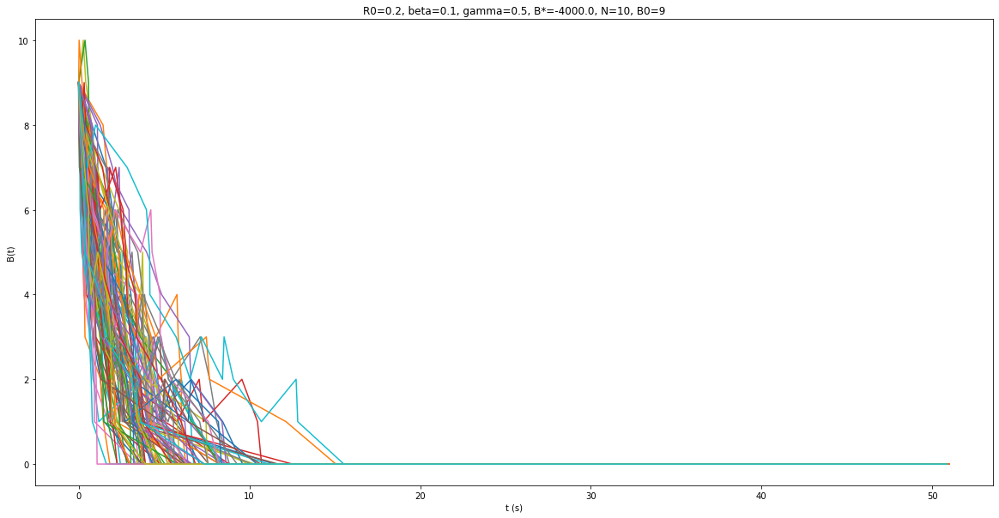

In [35]:
plotGillespie(10,1,0.1,0.5,50,100)
plotGillespie(10,9,0.1,0.5,50,100)

In the two plots above, we have a small R<sub>0</sub> again but we also have a small N. This appears to massively increase variance for small values for t for different iterations.

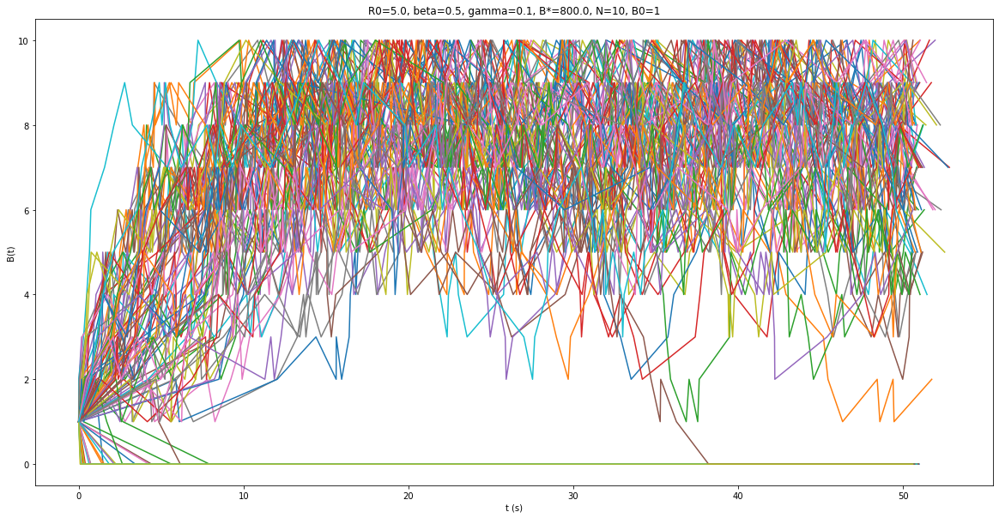

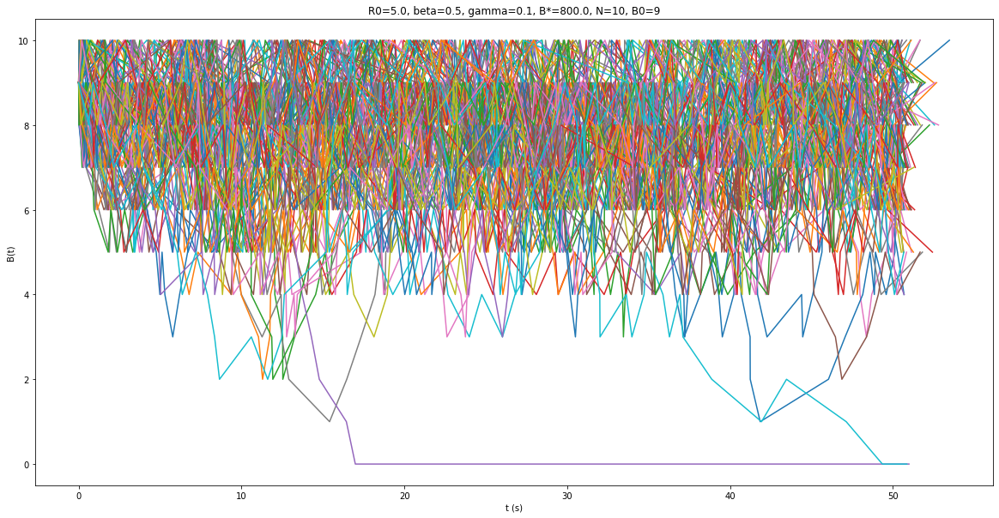

In [36]:
plotGillespie(10,1,0.5,0.1,50,100)
plotGillespie(10,9,0.5,0.1,50,100)

In the two plots above, we have a large R<sub>0</sub> again but we also have a small N. This appears to massively increase variance for all values for t for different iterations.

## Q2

I will now overlay an average for the Gillespie iterations, calculated by interpolating each iteration onto the same t values.

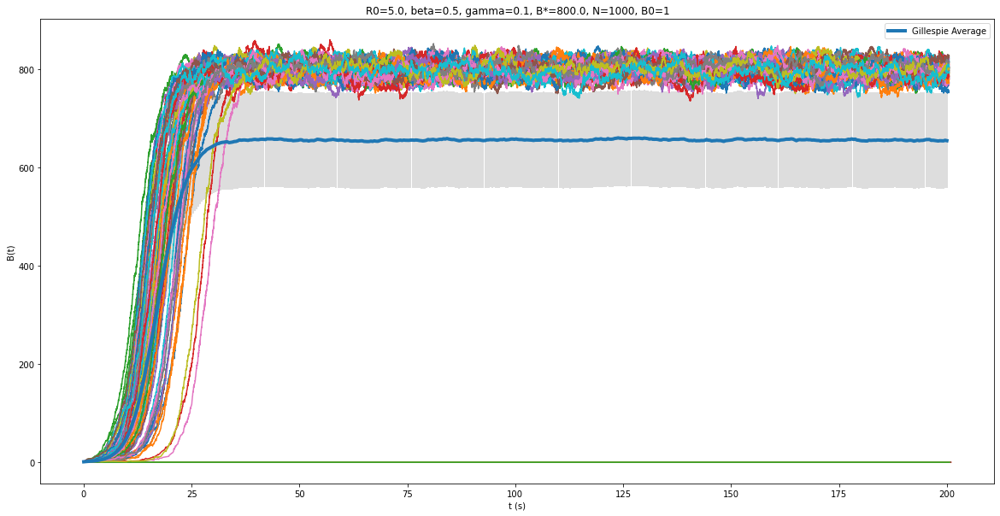

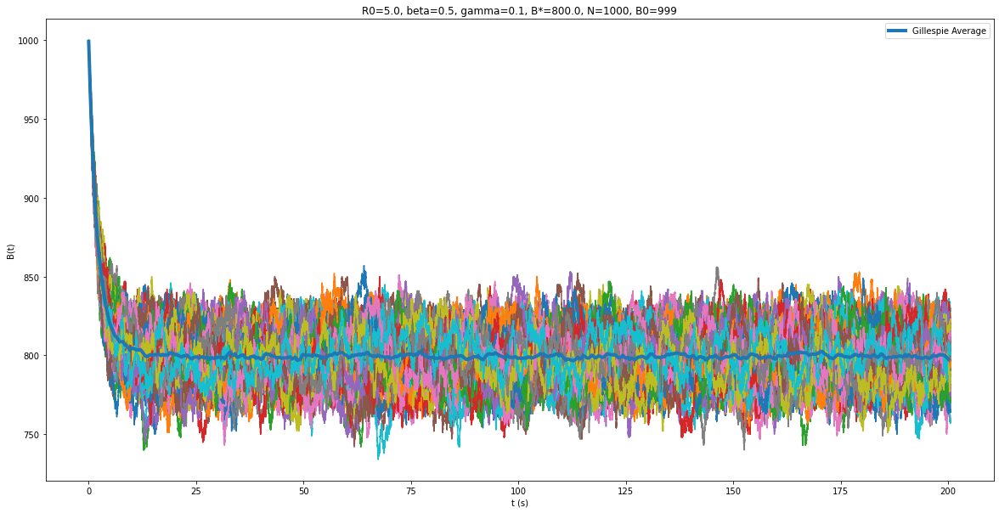

In [37]:
plotGillespie(1000,1,0.5,0.1,200,100,plotAvg=True)
plotGillespie(1000,999,0.5,0.1,200,100,plotAvg=True)

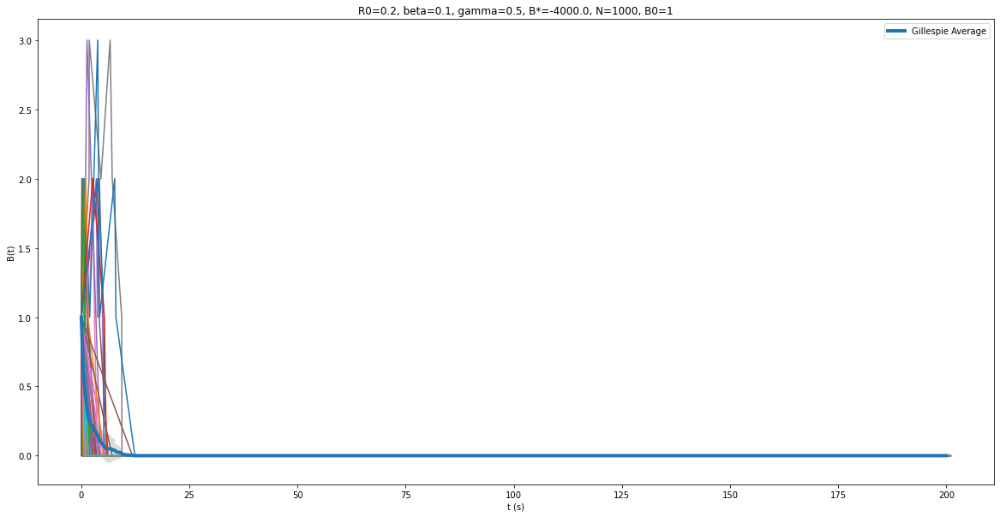

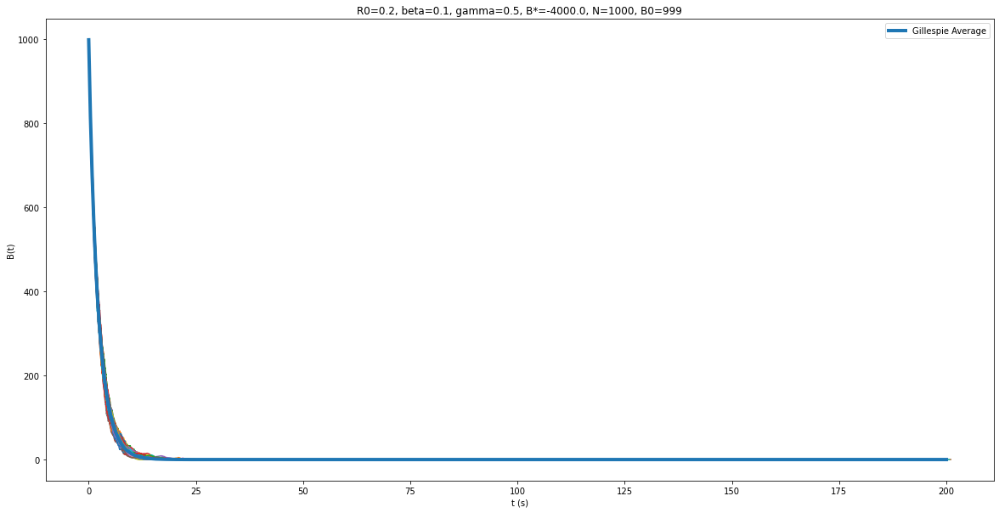

In [38]:
plotGillespie(1000,1,0.1,0.5,200,100,plotAvg=True)
plotGillespie(1000,999,0.1,0.5,200,100,plotAvg=True)

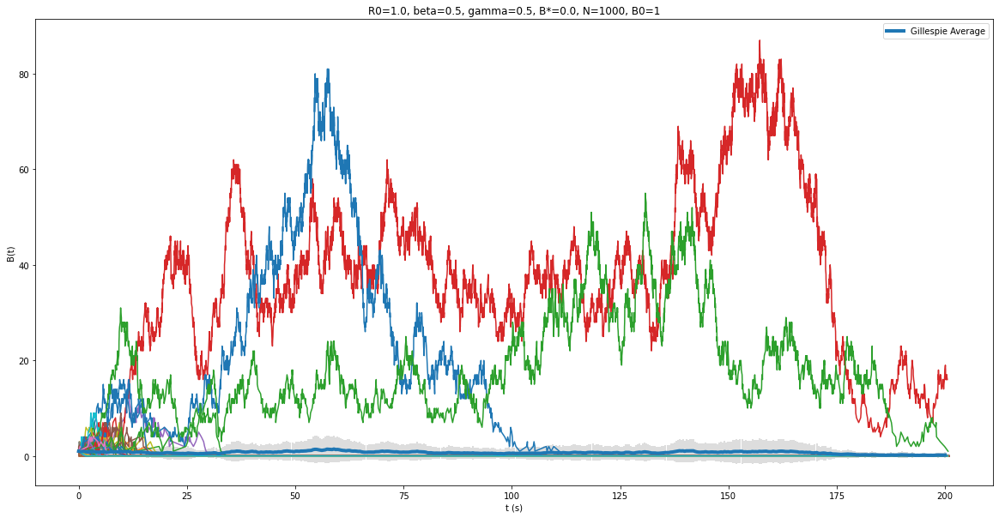

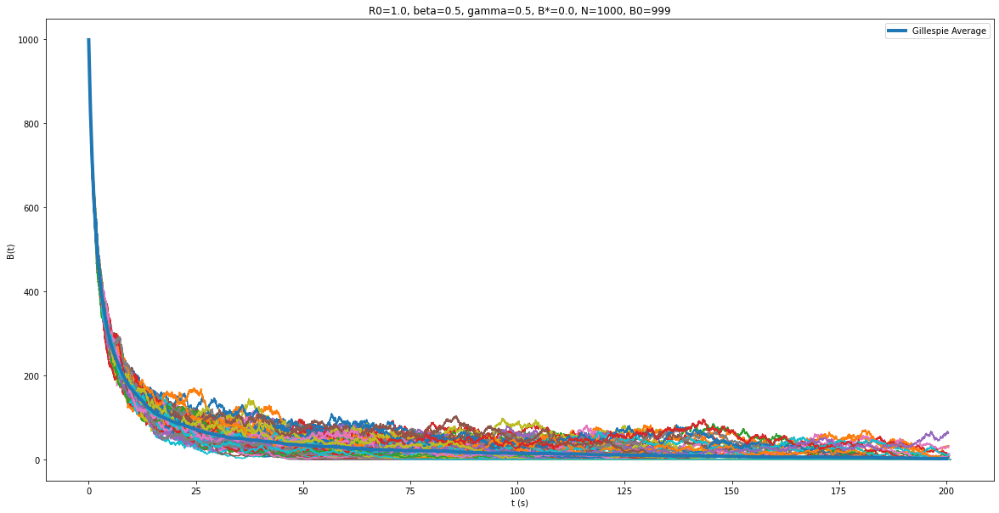

In [39]:
plotGillespie(1000,1,0.5,0.5,200,100,plotAvg=True)
plotGillespie(1000,999,0.5,0.5,200,100,plotAvg=True)

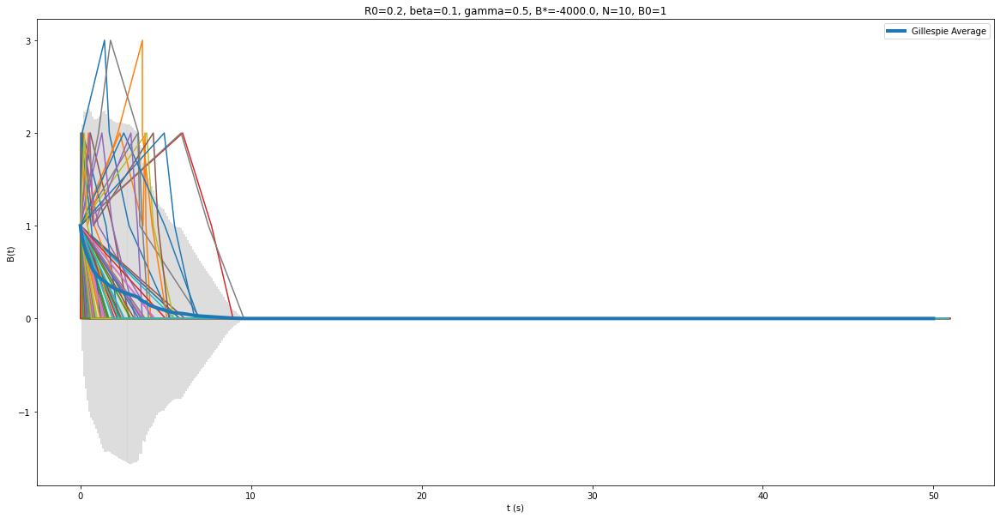

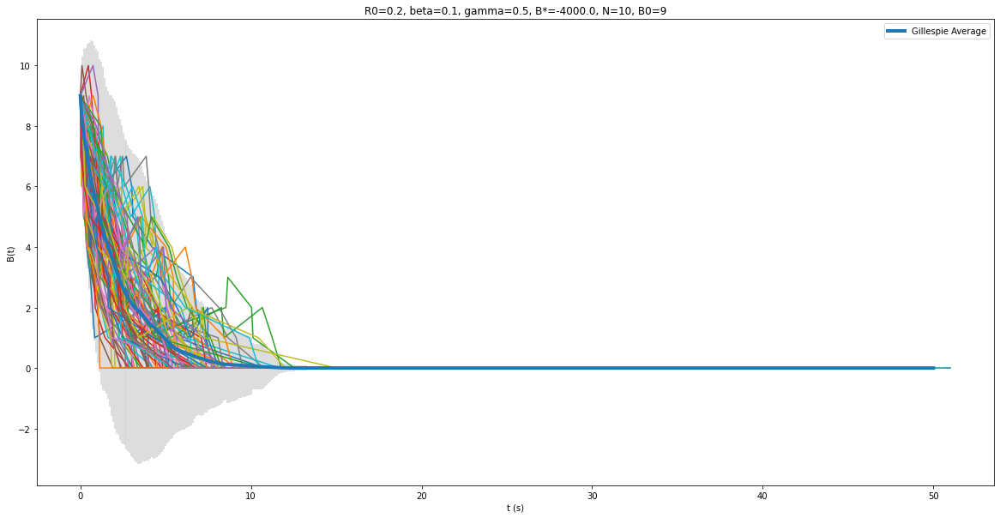

In [40]:
plotGillespie(10,1,0.1,0.5,50,100,plotAvg=True)
plotGillespie(10,9,0.1,0.5,50,100,plotAvg=True)

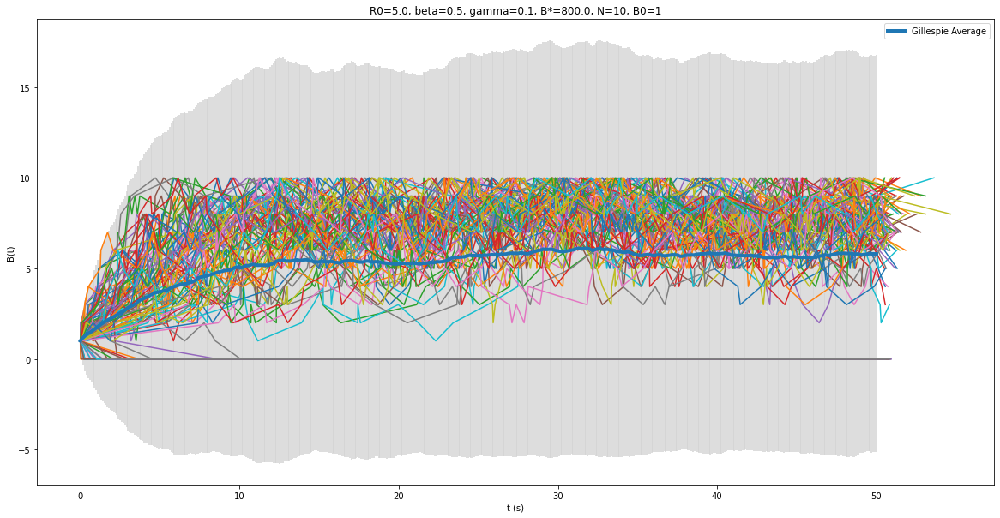

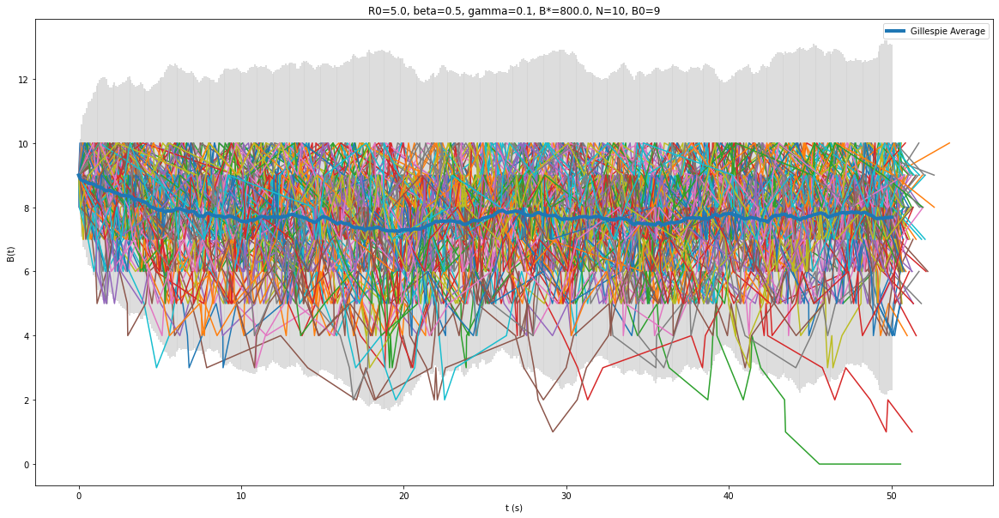

In [41]:
plotGillespie(10,1,0.5,0.1,50,100,plotAvg=True)
plotGillespie(10,9,0.5,0.1,50,100,plotAvg=True)

## Q3

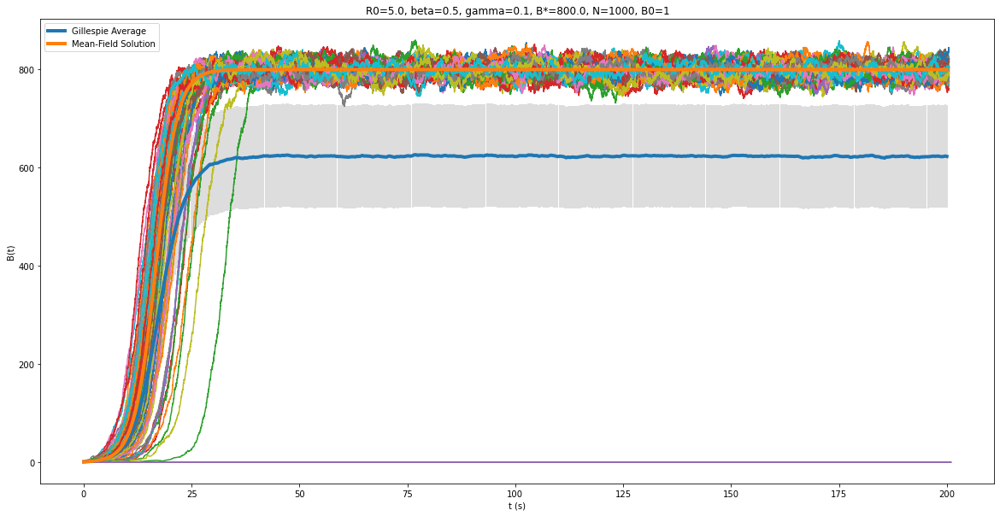

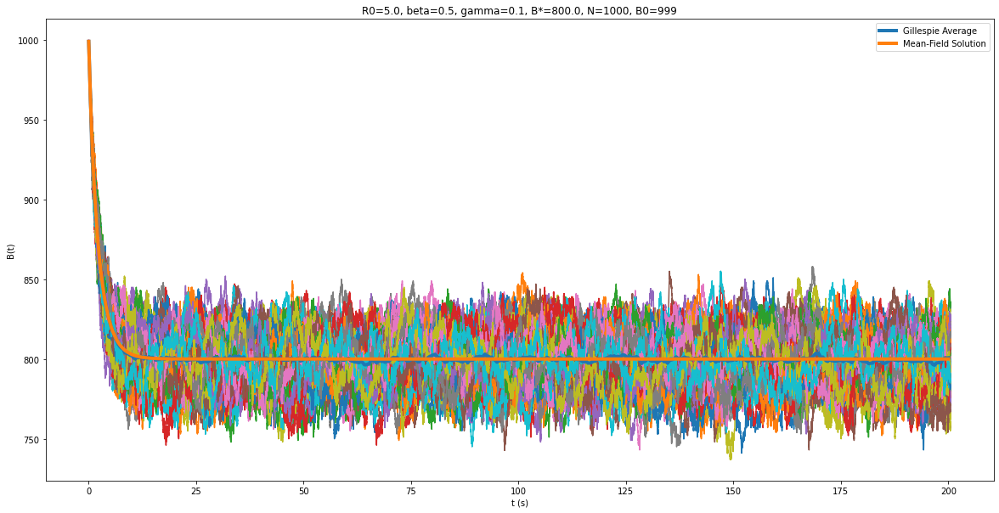

In [42]:
plotGillespie(1000,1,0.5,0.1,200,100,plotAvg=True,plotMF=True)
plotGillespie(1000,999,0.5,0.1,200,100,plotAvg=True,plotMF=True)

In the first plot above, the large disagreement between the mean-field solution and the Gillespie average appears to be due to the large standard deviations for the averages taken at each point, as the error bars are very large. We can see anomalous values skewing the average, particularly one Gillespie iteration converging to 0, very quickly, when most iterations and the mean-field solution don't.

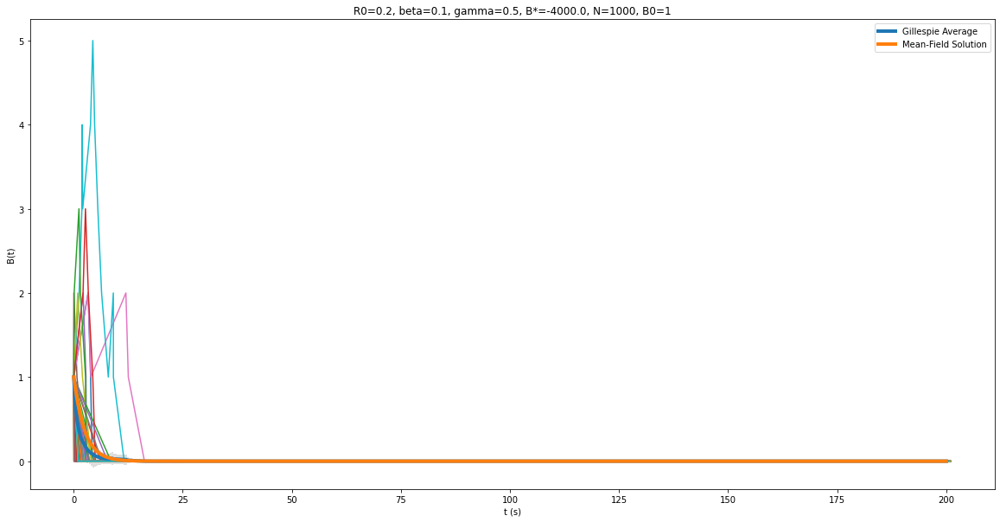

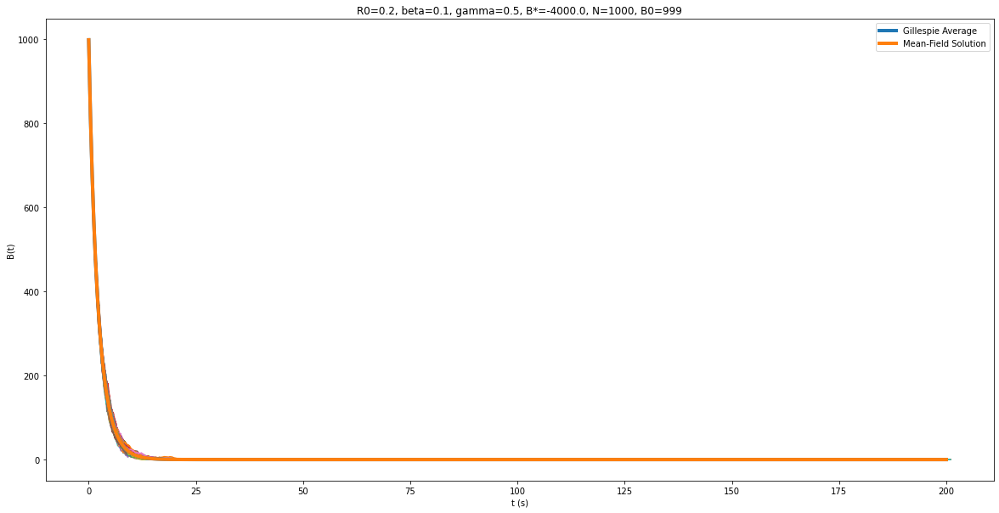

In [43]:
plotGillespie(1000,1,0.1,0.5,200,100,plotAvg=True,plotMF=True)
plotGillespie(1000,999,0.1,0.5,200,100,plotAvg=True,plotMF=True)

In the plots above, we appear to have good agreement between the average and the mean-field solution. The largest differences appear at small values for t, where we have a lot of fluctuations in the Gillespie iterations, due to the small B<sub>0</sub> chosen.

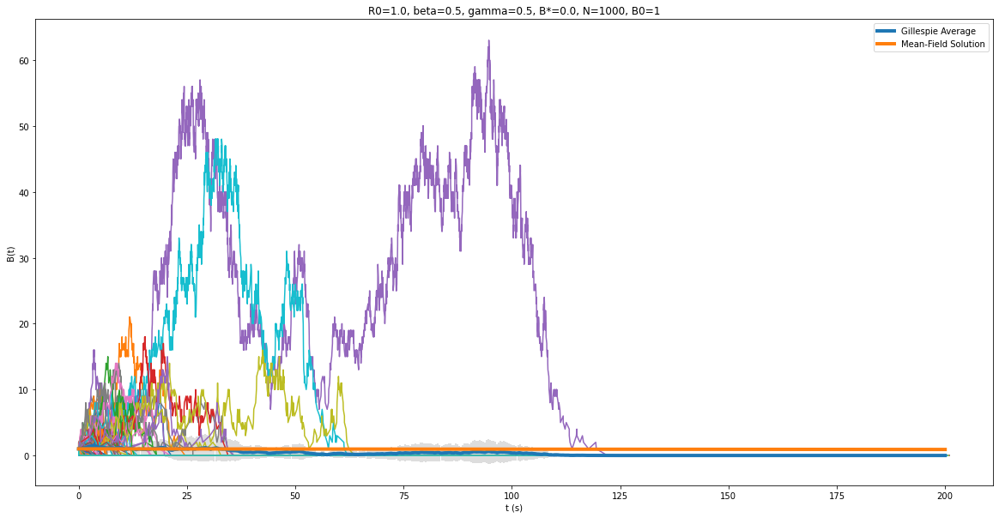

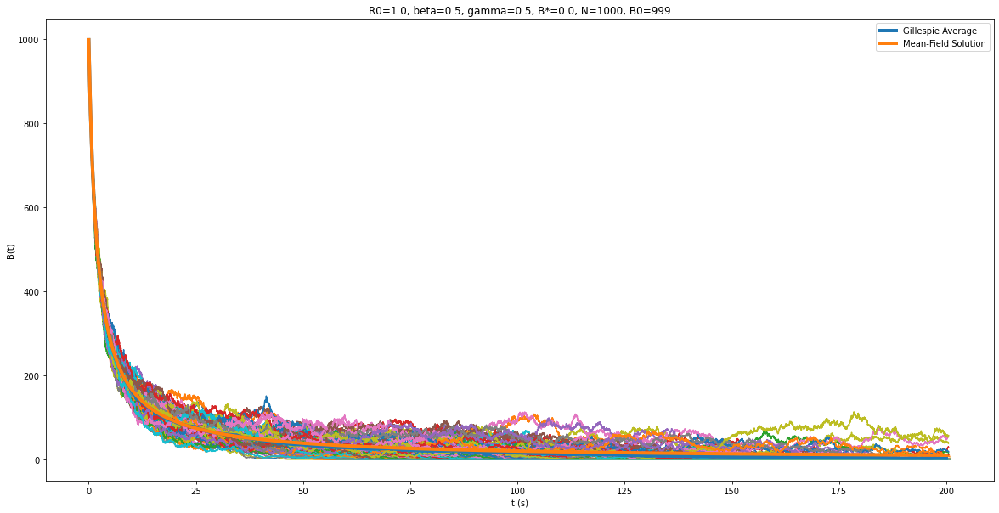

In [44]:
plotGillespie(1000,1,0.5,0.5,200,100,plotAvg=True,plotMF=True)
plotGillespie(1000,999,0.5,0.5,200,100,plotAvg=True,plotMF=True)

In the plota above, we appear to have good agreement between the average and the mean-field solution, until a difference appears as t gets quite large. Here R<sub>0</sub>=1, and we know that this is the value at which one fixed point (R<sub>0</sub><1) bifurcates into two (R<sub>0</sub>>1), from the bifurcation plot earlier. For Gillespie, most iterations appear to converge to 0 faster than the mean-field solution.

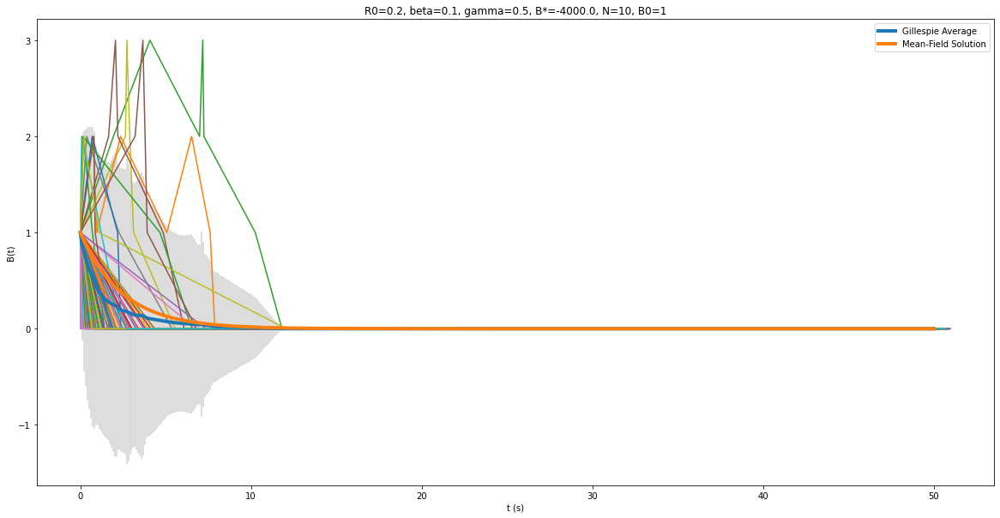

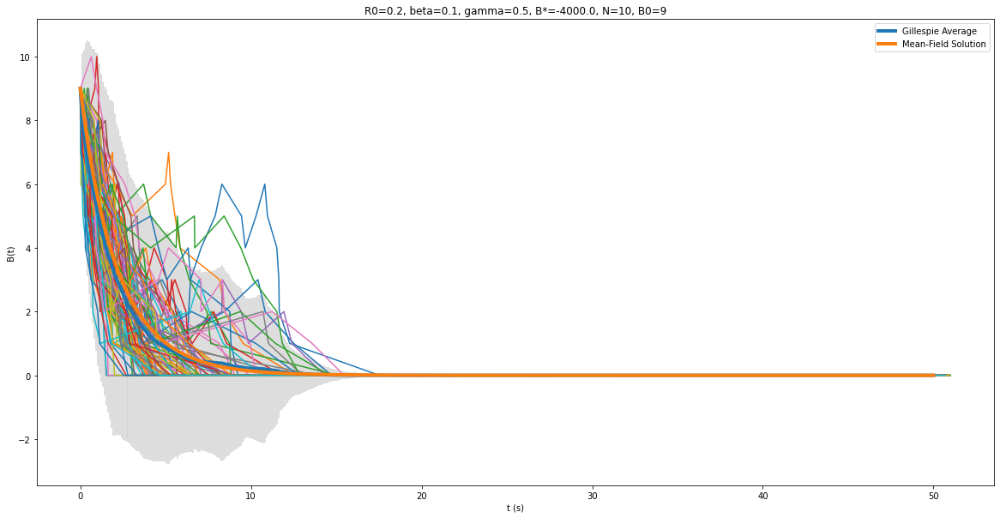

In [45]:
plotGillespie(10,1,0.1,0.5,50,100,plotAvg=True,plotMF=True)
plotGillespie(10,9,0.1,0.5,50,100,plotAvg=True,plotMF=True)

The disagreements between the Gillespie averages and mean-field solutions in the plots above and below, I propose are caused by the large errors, caused by the small B<sub>0</sub> and N values

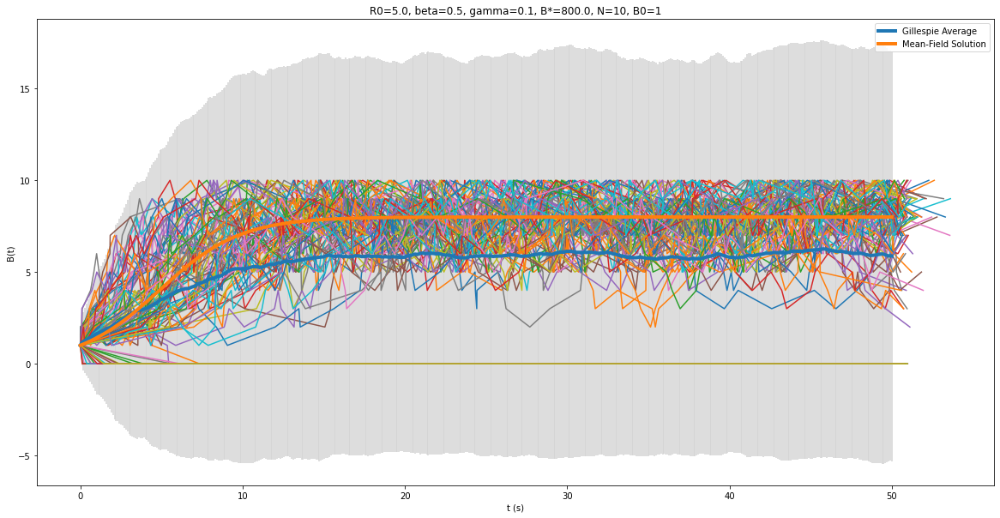

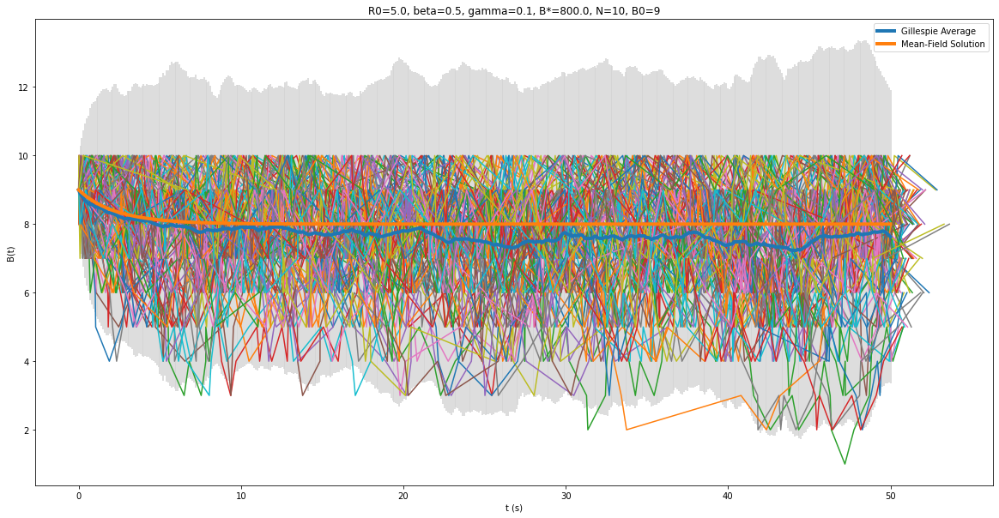

In [46]:
plotGillespie(10,1,0.5,0.1,50,100,plotAvg=True,plotMF=True)
plotGillespie(10,9,0.5,0.1,50,100,plotAvg=True,plotMF=True)

## Q4

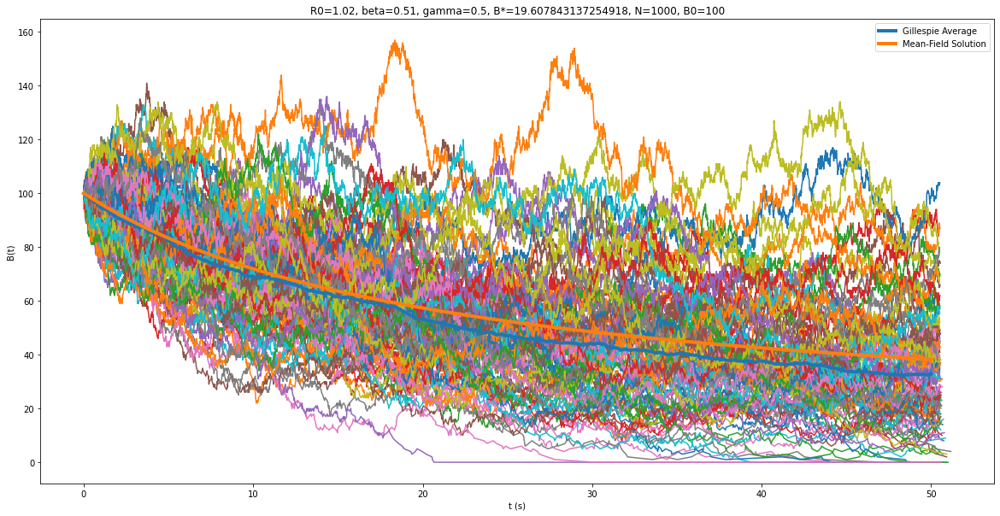

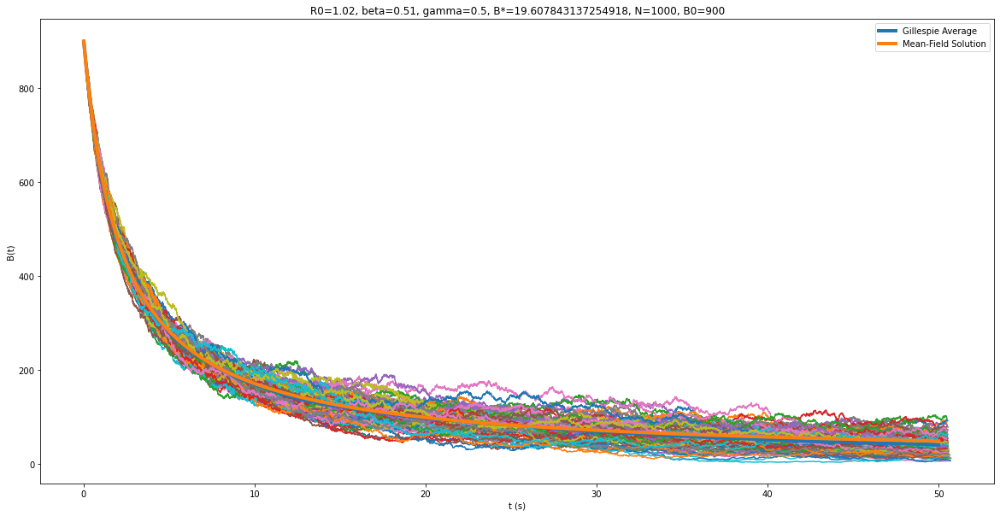

In [47]:
plotGillespie(1000,100,0.51,0.5,50,100,plotAvg=True,plotMF=True)
plotGillespie(1000,900,0.51,0.5,50,100,plotAvg=True,plotMF=True)

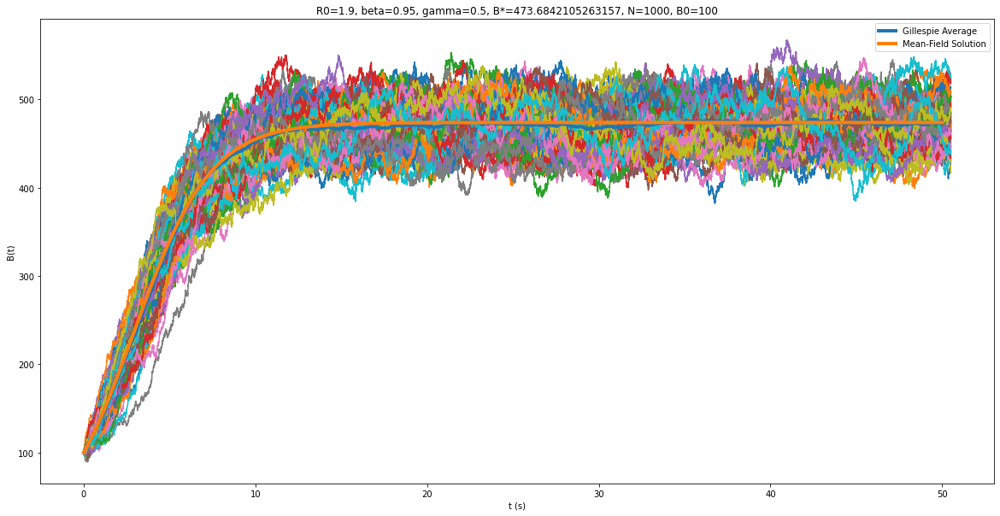

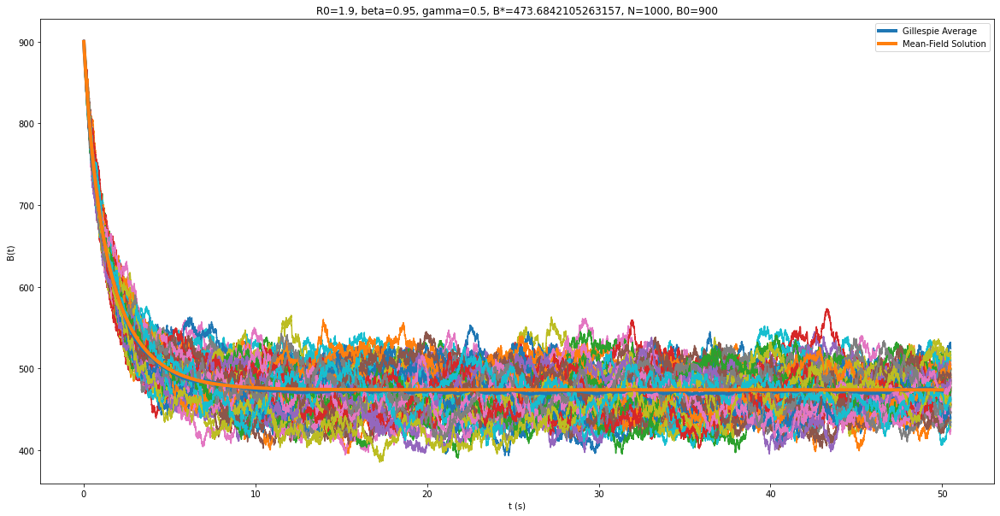

In [48]:
plotGillespie(1000,100,0.95,0.5,50,100,plotAvg=True,plotMF=True)
plotGillespie(1000,900,0.95,0.5,50,100,plotAvg=True,plotMF=True)

The scenario plotted above with disagreement between the Gillespie average and the mean-field solution is where R<sub>0</sub> is very close to 1. There appears to be a lot more noise, with some Gillespie iterations converging to 0 very quickly, and some fluctuating a lot. I will attempt to calculate the average, removing outliers by taking only the interquartile values at each t, to see if this improves agreement.

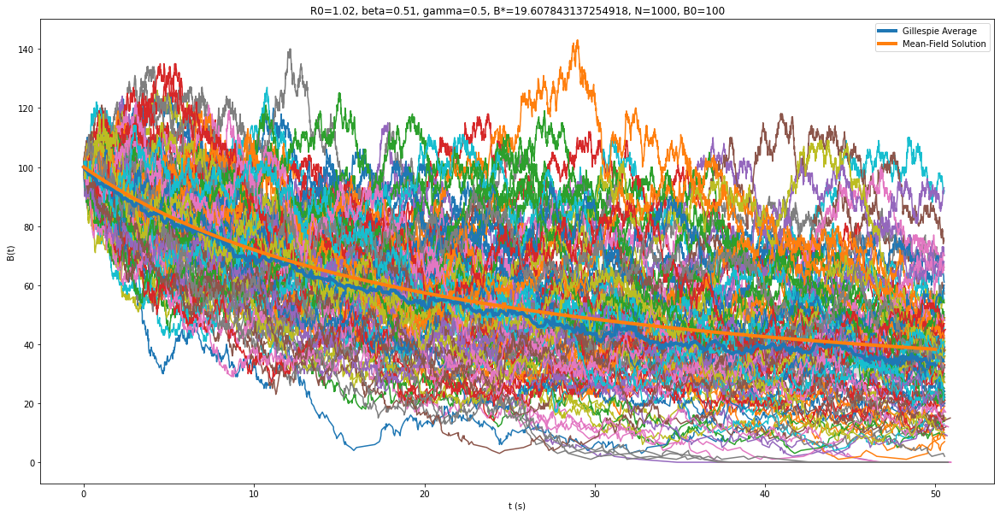

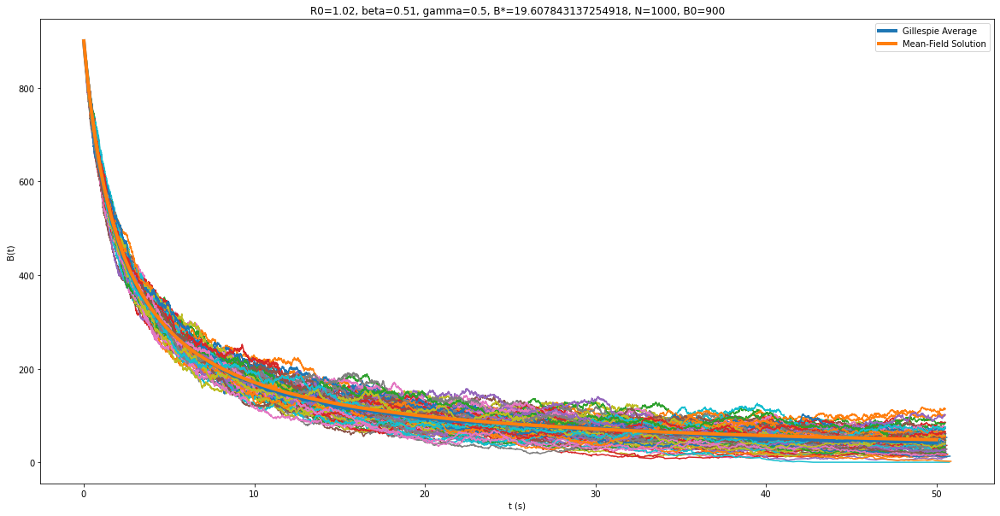

In [49]:
plotGillespie(1000,100,0.51,0.5,50,100,plotAvg=True,plotMF=True,removeOutliers=True)
plotGillespie(1000,900,0.51,0.5,50,100,plotAvg=True,plotMF=True,removeOutliers=True)

There appears to be some improvement, but there is still some disagreement.

# Critical Thinking

## Q1

One example of a real-world scenario that this model could apply to is for disease transmission in epidemiology, where we want a transmission rate less than R<sub>0</sub>=1 so that the infected population B decreases to 0. SIS models, where susceptible individuals become infected, then when they recover they immediately become susceptible again, look like the system we have analysed.

An example where we care about the equilibria instead of the critical regime could be in predicting longevity of fashion styles in popular culture. Assuming R<sub>0</sub> here is the rate at which any person in A, who has not does not conform to that style might choose to, if they come into contact with someone in B who does, we want to know what the equilibria are, particularly if there are more than one, so we know whether or not to keep producing clothes of that style.

## Q2

In a more likely scenario, individuals would only be in contact with a certain number of other individuals at any given time. If we look at SIS/SIR models, they take this into account with the choice of beta or b (The SIR Model for Spread of Disease - The Contact Number | Mathematical Association of America, 2022). This makes sense intuitively, as the rate of contact between an individual in state A and one in state B would appear to be proportional to both A and B, and therefore proportionally affect the movement of individuals from A to B. However, this still assumes a constant rate of contact for each individual with any other individual, whereas some individuals will be more likely to be in contact with each other, and some may never meet. If we wanted to amend the code for Gillespie to take this into account, we could input a series of NxN matrices C(t), where c<sub>i,j</sub>(t) is the element in the i<sup>th</sup> row and j<sup>th</sup> column of C(t), representing the whether or not there is contact for person i, with person j at any given time t, with 1 being yes, and 0 no. We would logically set the diagonal of each matrix to be zeroes, assuming an individual is not in contact with themself, as they can't "infect" themself. If we take an N length vector p(t), where p<sub>i</sub>(t) is the i<sup>th</sup> element of p(t), representing the state of an individual at time t, with 1 being in state B and 0 being in state A, then multiplying Cp, we would get a vector representing the number of individuals in state B in contact with any individual at a given time. Then, if that individual is in A, we can adjust the rate at which they might change to B at time t accordingly, which in the Gillespie code provided, would be found in 'rate_vector[A_contacts]'. I will not code this, however I would anticipate that this would make the system more chaotic, potentially affecting the stability of the non-zero fixed point.

# Bibliography

Maa.org. 2022. The SIR Model for Spread of Disease - The Contact Number | Mathematical Association of America. [online] Available at: <https://www.maa.org/press/periodicals/loci/joma/the-sir-model-for-spread-of-disease-the-contact-number> [Accessed 10 January 2022].